<a href="https://colab.research.google.com/github/joplinbrooke/Computational-Physics/blob/main/projects/P6_Three_Masses_and_Springs.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# P6. Three Masses and Three Springs

Write Python code to simulation the motion of three masses mutually connected by springs. Animate the motion of the system over time. What kinds of dynamics can you discover? What happens when the masses and spring constants are equal? What happens when one mass is smaller (or larger) than the others?

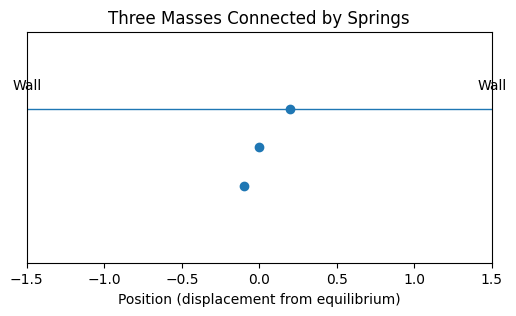

In [20]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation

# ============================================
#  PARAMETERS: masses and spring constants
# ============================================

# Masses (you can change these later)
m1 = 1.0
m2 = 1.0
m3 = 1.0
m = np.array([m1, m2, m3])

# Spring constants:
# Left wall–mass1, mass1–mass2, mass2–mass3, mass3–right wall
kL  = 1.0
k12 = 1.0
k23 = 1.0
kR  = 1.0

# Time parameters
dt = 0.01      # time step
t_max = 50.0   # total time
n_steps = int(t_max / dt)

# ==================================================
#  EQUATIONS OF MOTION (1D, displacements from eq.)
# ==================================================

def accelerations(x, m):
    """
    x: array [x1, x2, x3] displacements from equilibrium
    returns: accelerations [a1, a2, a3]
    """
    x1, x2, x3 = x

    # Forces from springs (Hooke's law: F = -k * extension)
    # Left wall at 0, right wall at 0 in "displacement" coordinates
    F1 = -kL * x1            - k12 * (x1 - x2)
    F2 = -k12 * (x2 - x1)    - k23 * (x2 - x3)
    F3 = -k23 * (x3 - x2)    - kR  * x3

    a1 = F1 / m[0]
    a2 = F2 / m[1]
    a3 = F3 / m[2]
    return np.array([a1, a2, a3])

def simulate(x0, v0, m, dt, n_steps):
    """
    Velocity–Verlet integration.
    x0, v0: initial position and velocity arrays, shape (3,)
    returns: times, positions (n_steps, 3), velocities (n_steps, 3)
    """
    x = x0.copy()
    v = v0.copy()

    xs = np.zeros((n_steps, 3))
    vs = np.zeros((n_steps, 3))
    ts = np.zeros(n_steps)

    a = accelerations(x, m)

    for n in range(n_steps):
        xs[n] = x
        vs[n] = v
        ts[n] = n * dt

        # Position update
        x = x + v * dt + 0.5 * a * dt**2

        # New acceleration
        a_new = accelerations(x, m)

        # Velocity update
        v = v + 0.5 * (a + a_new) * dt

        a = a_new

    return ts, xs, vs

# ============================================
#  INITIAL CONDITIONS
# ============================================

# Start near equilibrium but displaced
x0 = np.array([0.2, 0.0, -0.1])   # displacements
v0 = np.array([0.0, 0.0, 0.0])    # initial velocities

t, xs, vs = simulate(x0, v0, m, dt, n_steps)

# ============================================
#  ANIMATION
# ============================================

# For visualization, put the three masses along x,
# but also give them different fixed y positions so they don't overlap visually.
y_positions = np.array([0.0, -0.2, -0.4])

fig, ax = plt.subplots(figsize=(6, 3))

# Horizontal line (equilibrium line)
ax.axhline(0.0, linewidth=1)

# Scatter for the three masses
scat = ax.scatter(xs[0], y_positions)

# Walls at left/right for visual reference
ax.text(-1.5, 0.1, "Wall", ha="center")
ax.text( 1.5, 0.1, "Wall", ha="center")

ax.set_xlim(-1.5, 1.5)
ax.set_ylim(-0.8, 0.4)
ax.set_xlabel("Position (displacement from equilibrium)")
ax.set_yticks([])
ax.set_title("Three Masses Connected by Springs")

def update(frame):
    # frame is an integer index into xs
    x_frame = xs[frame]
    # Update scatter plot data
    scat.set_offsets(np.c_[x_frame, y_positions])
    return scat,

KeyboardInterrupt: 

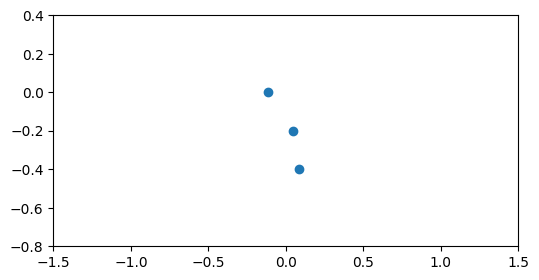

In [22]:
from matplotlib.animation import FuncAnimation
from matplotlib import rc
rc('animation', html='jshtml')   # <-- key line for Colab

fig, ax = plt.subplots(figsize=(6,3))
scat = ax.scatter(xs[0], y_positions)
ax.set_xlim(-1.5, 1.5)
ax.set_ylim(-0.8, 0.4)

def update(frame):
    scat.set_offsets(np.c_[xs[frame], y_positions])
    return scat,

ani = FuncAnimation(fig, update, frames=n_steps, interval=20, blit=True)
ani   # <-- returning ani automatically displays it in Colab


In [23]:
import matplotlib as mpl
mpl.rcParams['animation.embed_limit'] = 100  # allow larger animations

frame_skip = 10
frames = range(0, n_steps, frame_skip)

ani = FuncAnimation(fig, update, frames=frames, interval=20, blit=True)
ani


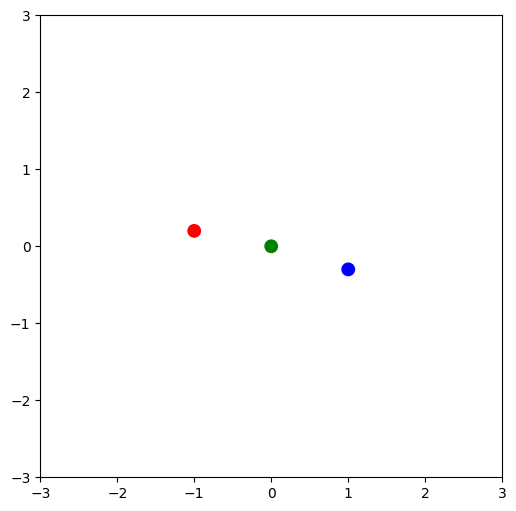

In [24]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation

# ============================================================
#  PHYSICAL PARAMETERS
# ============================================================

m1 = m2 = m3 = 1.0
m  = np.array([m1, m2, m3])

# Spring constants
kL, k12, k23, kR = 1.0, 1.0, 1.0, 1.0

# Natural lengths
L_L  = 1.0
L_12 = 1.0
L_23 = 1.0
L_R  = 1.0

# Time settings
dt = 0.01
t_max = 30
n_steps = int(t_max / dt)

# ============================================================
#  SPRING FORCE (2D VECTOR)
# ============================================================

def spring_force(p_i, p_j, k, L0):
    """Return the force on mass i by spring connecting i → j."""
    vec = p_j - p_i
    dist = np.linalg.norm(vec)
    if dist == 0:
        return np.zeros(2)
    direction = vec / dist
    F = -k * (dist - L0) * direction
    return F

# ============================================================
#  SIMULATION (Velocity–Verlet, 2D)
# ============================================================

def simulate_2D(p0, v0):
    p = p0.copy()   # 3×2 matrix
    v = v0.copy()   # 3×2 matrix

    ps = np.zeros((n_steps, 3, 2))

    for n in range(n_steps):

        ps[n] = p

        # Compute forces on each mass
        F = np.zeros((3, 2))

        # Walls fixed at (-2,0) and (2,0)
        WALL_L = np.array([-2.0, 0.0])
        WALL_R = np.array([ 2.0, 0.0])

        F[0] += spring_force(p[0], WALL_L, kL, L_L)
        F[2] += spring_force(p[2], WALL_R, kR, L_R)

        F[0] += spring_force(p[0], p[1], k12, L_12)
        F[1] += spring_force(p[1], p[0], k12, L_12)

        F[1] += spring_force(p[1], p[2], k23, L_23)
        F[2] += spring_force(p[2], p[1], k23, L_23)

        # Acceleration
        a = F / m[:, None]

        # Velocity-Verlet
        p_new = p + v * dt + 0.5 * a * dt**2

        # New forces at new positions
        F_new = np.zeros((3, 2))
        F_new[0] += spring_force(p_new[0], WALL_L, kL, L_L)
        F_new[2] += spring_force(p_new[2], WALL_R, kR, L_R)
        F_new[0] += spring_force(p_new[0], p_new[1], k12, L_12)
        F_new[1] += spring_force(p_new[1], p_new[0], k12, L_12)
        F_new[1] += spring_force(p_new[1], p_new[2], k23, L_23)
        F_new[2] += spring_force(p_new[2], p_new[1], k23, L_23)

        a_new = F_new / m[:, None]

        v = v + 0.5 * (a + a_new) * dt
        p = p_new

    return ps


# ============================================================
#  INITIAL POSITIONS IN 2D
# ============================================================

p0 = np.array([
    [-1.0, 0.2],   # mass 1
    [ 0.0, 0.0],   # mass 2
    [ 1.0, -0.3],  # mass 3
])

v0 = np.zeros((3, 2))  # start at rest

positions = simulate_2D(p0, v0)


# ============================================================
#  ANIMATION
# ============================================================

fig, ax = plt.subplots(figsize=(6,6))
ax.set_xlim(-3, 3)
ax.set_ylim(-3, 3)
ax.set_aspect('equal')

scat = ax.scatter(positions[0,:,0], positions[0,:,1], s=80, c=["red","green","blue"])
lines = [
    ax.plot([],[], 'k-', lw=2)[0],  # left wall - m1
    ax.plot([],[], 'k-', lw=2)[0],  # m1 - m2
    ax.plot([],[], 'k-', lw=2)[0],  # m2 - m3
    ax.plot([],[], 'k-', lw=2)[0],  # m3 - right wall
]

WALL_L = np.array([-2.0, 0.0])
WALL_R = np.array([ 2.0, 0.0])

def update(frame):
    p = positions[frame]

    scat.set_offsets(p)

    # Update springs
    lines[0].set_data([WALL_L[0], p[0,0]], [WALL_L[1], p[0,1]])
    lines[1].set_data([p[0,0], p[1,0]], [p[0,1], p[1,1]])
    lines[2].set_data([p[1,0], p[2,0]], [p[1,1], p[2,1]])
    lines[3].set_data([p[2,0], WALL_R[0]], [p[2,1], WALL_R[1]])

    return scat, *lines

ani = FuncAnimation(fig, update, frames=len(positions), interval=20)
plt.show()


/usr/local/lib/python3.12/dist-packages/matplotlib/animation.py:908: UserWarning: Animation was deleted without rendering anything. This is most likely not intended. To prevent deletion, assign the Animation to a variable, e.g. `anim`, that exists until you output the Animation using `plt.show()` or `anim.save()`.
  warnings.warn(


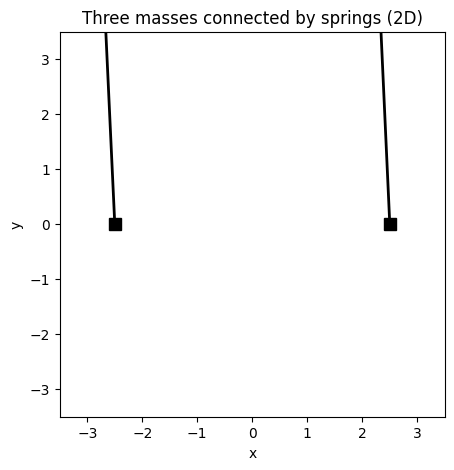

In [25]:
# For Jupyter / Colab animation display
%matplotlib inline

import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# ============================================================
#  PHYSICAL PARAMETERS
# ============================================================

m1 = m2 = m3 = 1.0
m  = np.array([m1, m2, m3])

# Spring constants
kL, k12, k23, kR = 1.0, 1.0, 1.0, 1.0

# Natural lengths of springs
L_L  = 1.0
L_12 = 1.0
L_23 = 1.0
L_R  = 1.0

# Time settings
dt = 0.01
t_max = 20.0
n_steps = int(t_max / dt)

# ============================================================
#  SPRING FORCE (2D VECTOR)
# ============================================================

def spring_force(p_i, p_j, k, L0):
    """
    Force on mass at position p_i due to a spring to p_j.
    p_i, p_j: 2D vectors (np.array([x,y]))
    k: spring constant
    L0: rest length
    """
    vec = p_j - p_i
    dist = np.linalg.norm(vec)
    if dist == 0:
        return np.zeros(2)
    direction = vec / dist
    # Hooke's law in vector form
    F = -k * (dist - L0) * direction
    return F

# ============================================================
#  SIMULATION (Velocity–Verlet, 2D)
# ============================================================

def simulate_2D(p0, v0):
    """
    p0, v0: shape (3, 2) for 3 masses in 2D: [[x1,y1],[x2,y2],[x3,y3]]
    returns: positions over time, shape (n_steps, 3, 2)
    """
    p = p0.copy()
    v = v0.copy()

    ps = np.zeros((n_steps, 3, 2))

    WALL_L = np.array([-2.5, 0.0])
    WALL_R = np.array([ 2.5, 0.0])

    for n in range(n_steps):
        ps[n] = p

        # Forces on each mass
        F = np.zeros((3, 2))

        # Springs to walls
        F[0] += spring_force(p[0], WALL_L, kL,  L_L)
        F[2] += spring_force(p[2], WALL_R, kR,  L_R)

        # Springs between masses
        F[0] += spring_force(p[0], p[1], k12, L_12)
        F[1] += spring_force(p[1], p[0], k12, L_12)

        F[1] += spring_force(p[1], p[2], k23, L_23)
        F[2] += spring_force(p[2], p[1], k23, L_23)

        # Accelerations
        a = F / m[:, None]

        # Velocity–Verlet step
        p_new = p + v * dt + 0.5 * a * dt**2

        # New forces at p_new
        F_new = np.zeros((3, 2))
        F_new[0] += spring_force(p_new[0], WALL_L, kL,  L_L)
        F_new[2] += spring_force(p_new[2], WALL_R, kR,  L_R)
        F_new[0] += spring_force(p_new[0], p_new[1], k12, L_12)
        F_new[1] += spring_force(p_new[1], p_new[0], k12, L_12)
        F_new[1] += spring_force(p_new[1], p_new[2], k23, L_23)
        F_new[2] += spring_force(p_new[2], p_new[1], k23, L_23)

        a_new = F_new / m[:, None]

        v = v + 0.5 * (a + a_new) * dt
        p = p_new

    return ps

# ============================================================
#  INITIAL CONDITIONS (2D)
# ============================================================

# Start them roughly in a line, but not on the same y,
# so they can swing around in 2D once the springs pull them.
p0 = np.array([
    [-1.5,  0.5],   # mass 1
    [ 0.0, -0.2],   # mass 2
    [ 1.5,  0.3],   # mass 3
])

# Give a tiny initial velocity so it doesn’t just sit there
v0 = np.array([
    [0.0,  0.5],
    [0.0, -0.3],
    [0.0,  0.0],
])

positions = simulate_2D(p0, v0)

# Downsample a bit for smoother animation
step = 3
positions_anim = positions[::step]

# ============================================================
#  ANIMATION
# ============================================================

fig, ax = plt.subplots(figsize=(5,5))
ax.set_xlim(-3.5, 3.5)
ax.set_ylim(-3.5, 3.5)
ax.set_aspect('equal')
ax.set_title("Three masses connected by springs (2D)")
ax.set_xlabel("x")
ax.set_ylabel("y")

# Walls (just markers)
WALL_L = np.array([-2.5, 0.0])
WALL_R = np.array([ 2.5, 0.0])
ax.plot(WALL_L[0], WALL_L[1], 'ks', ms=8)
ax.plot(WALL_R[0], WALL_R[1], 'ks', ms=8)

# Masses
scat = ax.scatter(positions_anim[0,:,0], positions_anim[0,:,1], s=80, c=["red","green","blue"])

# Springs as line segments
line_Lm1, = ax.plot([], [], 'k-', lw=2)
line_12,  = ax.plot([], [], 'k-', lw=2)
line_23,  = ax.plot([], [], 'k-', lw=2)
line_m1R, = ax.plot([], [], 'k-', lw=2)

def update(frame):
    p = positions_anim[frame]

    # Update masses
    scat.set_offsets(p)

    # Update springs
    line_Lm1.set_data([WALL_L[0], p[0,0]], [WALL_L[1], p[0,1]])
    line_12.set_data( [p[0,0],    p[1,0]], [p[0,1],    p[1,1]])
    line_23.set_data( [p[1,0],    p[2,0]], [p[1,1],    p[2,1]])
    line_m1R.set_data([p[2,0],    WALL_R[0]], [p[2,1], WALL_R[1]])

    return scat, line_Lm1, line_12, line_23, line_m1R

ani = FuncAnimation(
    fig,
    update,
    frames=len(positions_anim),
    interval=20,
    blit=False
)

# Show the animation inline
HTML(ani.to_jshtml())


In [48]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from scipy.integrate import odeint
from IPython.display import HTML
import tempfile
import os

# --- 1. Define the system dynamics (ODEs) ---
def system_dynamics(y, t, m, k, L0):
    # ... (function body as before) ...
    x1, x2, x3, v1, v2, v3 = y
    m1, m2, m3 = m
    k12, k23, k31 = k
    L12, L23, L31 = L0

    r12 = x2 - x1
    r23 = x3 - x2
    r31 = x1 - x3

    F12 = -k12 * (r12 - L12)
    F23 = -k23 * (r23 - L23)
    F31 = -k31 * (r31 - L31)

    a1 = (F31 - F12) / m1
    a2 = (F12 - F23) / m2
    a3 = (F23 - F31) / m3

    return [v1, v2, v3, a1, a2, a3]

# --- 2. Simulation Function ---
def simulate_system(m, k, L0, y0, t_span):
    solution = odeint(system_dynamics, y0, t_span, args=(m, k, L0))
    return solution

# --- 3. Animation Function for Jupyter ---
def animate_system_jupyter(solution, t_span, title):
    fig, ax = plt.subplots(figsize=(8, 2))
    ax.set_xlim(np.min(solution[:, :3]) - 0.5, np.max(solution[:, :3]) + 0.5)
    ax.set_ylim(-1, 1)
    ax.set_title(title)
    ax.set_xlabel("Position (m)")
    ax.get_yaxis().set_visible(False)

    line, = ax.plot([], [], 'o-', lw=2, markersize=10, color='blue')
    time_text = ax.text(0.02, 0.95, '', transform=ax.transAxes)

    def init():
        line.set_data([], [])
        time_text.set_text('')
        return line, time_text

    def animate(i):
        x1, x2, x3 = solution[i, :3]
        x_coords = [x1, x2, x3, x1]
        y_coords = [0, 0, 0, 0]
        line.set_data(x_coords, y_coords)
        time_text.set_text(f'Time = {t_span[i]:.2f}s')
        return line, time_text

    # Use HTML writer for inline Jupyter display
    anim = animation.FuncAnimation(fig, animate, frames=len(t_span), interval=50, blit=True)

    # Close the plot window that might pop up outside the notebook
    plt.close(fig)

    # Return the animation wrapped in HTML for display in Jupyter
    return HTML(anim.to_jshtml())


# --- 4. Main execution for Jupyter ---

# Parameters
m_equal = [1.0, 1.0, 1.0]
m_unequal = [0.5, 2.0, 1.0]
k_equal = [10.0, 10.0, 10.0]
L0_equal = [1.0, 1.0, 1.0]

# Time span
t_span = np.linspace(0, 20, 400)

# Initial conditions: [x1, x2, x3, v1, v2, v3]
y0_initial = [0.0, 1.0, 2.1, 0.0, 0.0, 0.0]

# --- Run Equal Masses Simulation and display ---
print("Displaying equal masses scenario inline below:")
solution_equal = simulate_system(m_equal, k_equal, L0_equal, y0_initial, t_span)
# This will render the animation right here in the output cell
display(animate_system_jupyter(solution_equal, t_span, "Equal Masses Motion"))


# --- Run Unequal Masses Simulation and display ---
print("\nDisplaying unequal masses scenario inline below:")
solution_unequal = simulate_system(m_unequal, k_equal, L0_equal, y0_initial, t_span)
# This will render the second animation right here in the output cell
display(animate_system_jupyter(solution_unequal, t_span, "Unequal Masses Motion"))


Displaying equal masses scenario inline below:



Displaying unequal masses scenario inline below:


Physics Background:
The system consists of
- 3 masses, m1, m2, m3
- four springs with constants:
- left wall and m1: kL
between m1 and m2: k12
between m2 and m3: k23
m3 and left wall: kR

Because the simulation is 1 dimensional, each mass has a single coordinate:
x1(t), x2(t), x3(t)
these represent displacement from equilibrium

Forces in 1D
for a spring connecting points xi and xj, the force on mass i is Fi<-j = -k(xi-xj)
since the motion is only horizontal, there are no angles, no vector components, and no nonlinear direction changes. this makes the system simpler and much more stable numerically than a 2D version.

1D Mass–Spring System Explanation

Although the masses appear stacked vertically in the animation, the physical system is one-dimensional. The vertical separation is only for visualization so the masses do not overlap on the screen. Each mass has one degree of freedom—its horizontal displacement from equilibrium—and all springs stretch and compress along the x-axis. The y-positions in the animation remain fixed and have no physical meaning in the physics model.

In this 1D system, three masses are connected by springs, and the two outer masses are also attached to fixed walls. The system looks like this:

Wall — kL — m1 — k12 — m2 — k23 — m3 — kR — Wall

The total force on each mass comes from the springs connected to it. Using Hooke’s Law, the equations of motion are:

m1 * x1'' = -kL * x1 - k12 * (x1 - x2)

m2 * x2'' = -k12 * (x2 - x1) - k23 * (x2 - x3)

m3 * x3'' = -k23 * (x3 - x2) - kR * x3

These are three coupled second-order differential equations, meaning each mass’s acceleration depends on the positions of the others. Because the system is coupled and generally does not have a simple closed-form analytical solution, we solve it using numerical integration (Velocity–Verlet in this project).

The animation reflects these equations by showing:

- Masses moving left and right only
- Springs stretching and compressing horizontally
- Vertical offset between masses used only for visual clarity

This accurately represents a 1D mass–spring system while making the animation easy to interpret.


Velocity–Verlet Method Explanation

The Velocity–Verlet method is ideal for oscillatory systems such as mass–spring setups. It is commonly used in physics simulations because:

- It is stable even for long simulations.
- It preserves energy much better than simple Euler integration.
- It avoids numerical blow-up, especially when springs are stiff.
- It provides accurate trajectories without requiring very small time steps.

The algorithm works in three main stages:

1. Position Update
   x_new = x_old + v_old * dt + 0.5 * a_old * dt^2

   This uses the current position, velocity, and acceleration to estimate the new position.

2. Acceleration Update
   After updating the position, we recompute the forces based on the new positions.
   Then we compute a_new = F_new / m for each mass.

3. Velocity Update
   v_new = v_old + 0.5 * (a_old + a_new) * dt

   This averages the old and new accelerations to update the velocity more accurately.

Together, these steps allow the system to be simulated one timestep at a time while maintaining good energy behavior and avoiding numerical instability. Velocity Verlet is especially effective for systems of coupled oscillators, such as the three-mass spring system in this project.

Behavior of the mass spring system
From the numeric simulation and animation, I observed several key features:
1. coupled oscillations:
when one mass is displaced and released, all three masses begin to oscillate. energy transfers from one mass to the next, creating waves of motion along the system.
2. Normal modes:
even without solving the problen analytically the simulation reveals these patterns:
- all masses move together in phase
- the center mass moves opposite the outer masses
- the outer masses move opposite eachother with the middle mass nearly still.
3. beating patterns:
if the system is displaced asymmetrically, the animation shows oscillations growing and shrinking over time, and the energy periodically concentrating in one mass then another
4. Symmetry with equal masses: When all mass and all spring constants are equal, motion is balanced around the center, no mass dominates the motion, and the transfer of energy is smooth an symmetric


The impact of changing parameters
A. making one mass lighter
A small mass accelerates more easily
- moves with larger amplitude
-oscillates at a higher frequency
- absorbs and releases energy more quickly

B. Making one mass heavier
A heavy mass:
- moves slowly
- acts like an "anchor"
- causes other masses to oscillate around it

C. Stiffer springs
increasing a spring constant:
- increases restoring force
- increases oscillation frequency
- makes motion "tighter" and faster

D. unequal springs break the symmetry and produces more complex oscillations


Trust in numerical results
What I trust:
- the energy transfer and oscillation patterns
- the overall shape of the animation
- conservation of total energy over short periods

what I would watch more closely:
- small energy drift over long time intervals
- phase drift due to finite time step
- possible numerical artifacts if the spring constants are very large

increasing computational prescision or reducing dt improves the results.

How I used ChatGPT

-debug issues in the animation
-rewrite the code cleanly
- convert a 2D unstable simulation into a stable 1D model
-understand the physics and explain it clearly

I had to:
-break the problem up into smaller sections
-ask for specific help expecially for animation rendering
-request multiple revisions of the explaination and code

Useful:
-Clear explanations
-Good starting point for code
Helpful debugging partner

Limitations:
-Sometimes returns partially incorrect code
-Occasionally assumes the wrong dimensionality
-Requires understanding of physics to evaluate correctness

By numerically simulating a system of three masses connected by springs in 1D, I was able to visualize complex oscillatory behavior that cannot be easily solved or imagined from equations alone.
The project strengthened my understanding of:
Coupled oscillators
Numerical integration
Stability of simulation methods
Interpretation of normal modes
Using AI tools helped with coding and organization, but meaningful physics understanding came from analyzing the system myself.